# Page-1 (Dhyey Rabadiya)

### Retrieving images, merging them, and converting them to cartoon

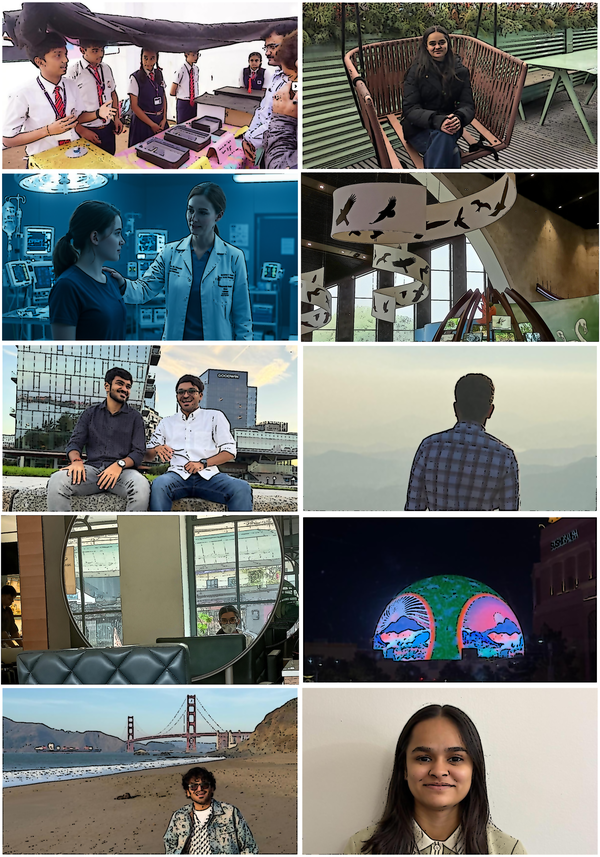

In [4]:
import cv2
import numpy as np
import PIL.Image
import os
from IPython.display import display

# Function to apply cartoon effect
def cartoonify(image):
    # Convert to grayscale
    gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    
    # Apply median blur
    blur = cv2.medianBlur(gray, 5)
    
    # Detect edges using adaptive thresholding
    edges = cv2.adaptiveThreshold(blur, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, 9, 9)
    
    # Apply bilateral filter to smoothen colors
    color = cv2.bilateralFilter(image, 9, 300, 300)
    
    # Combine color image with edges
    cartoon = cv2.bitwise_and(color, color, mask=edges)
    
    return cartoon

# Function to add a border to an image
def add_border(image, border_size=10, border_color=(255, 255, 255)):  # Default white border
    width, height = image.size
    new_width = width + (border_size * 2)
    new_height = height + (border_size * 2)
    
    # Create new image with border
    bordered_image = PIL.Image.new("RGB", (new_width, new_height), border_color)
    bordered_image.paste(image, (border_size, border_size))
    
    return bordered_image

# List of image paths
list_im = [
    r'Images/image1.jpg',
    r'Images/image2.jpg',
    r'Images/image3.jpg',
    r'Images/image4.jpg',
    r'Images/image5.jpg',
    r'Images/image6.jpg',
    r'Images/image7.jpg',
    r'Images/image8.jpg',
    r'Images/image9.jpg',
    r'Images/image10.jpg'
]

# Ensure all images are loaded correctly
imgs = []
for path in list_im:
    try:
        img = PIL.Image.open(path).convert("RGB")
        imgs.append(img)
    except Exception as e:
        print(f"Error loading {path}: {e}")
        imgs.append(PIL.Image.new("RGB", (600, 400), "black"))  # Placeholder black image

# Convert images to NumPy arrays and apply cartoon effect
cartoon_imgs = [cartoonify(np.array(img)) for img in imgs]

# Convert back to PIL images and add border
cartoon_imgs_pil = [add_border(PIL.Image.fromarray(img), border_size=10, border_color=(255, 255, 255)) for img in cartoon_imgs]

# Resize all images to the smallest found size
min_shape = sorted([(i.size[0] * i.size[1], i.size) for i in cartoon_imgs_pil])[0][1]
imgs_resized = [i.resize(min_shape, PIL.Image.Resampling.LANCZOS) for i in cartoon_imgs_pil]

# Arrange images in a 2-column, 5-row grid
rows = 5
cols = 2
img_width, img_height = min_shape
final_image = PIL.Image.new('RGB', (img_width * cols, img_height * rows), (0, 0, 0))  # Black background

for index, img in enumerate(imgs_resized):
    x_offset = (index % cols) * img_width
    y_offset = (index // cols) * img_height
    final_image.paste(img, (x_offset, y_offset))

# Resize for better display
max_width = 600
aspect_ratio = final_image.height / final_image.width
new_height = int(max_width * aspect_ratio)
final_image_resized = final_image.resize((max_width, new_height), PIL.Image.Resampling.LANCZOS)

# Save and display
output_path = r'Images/page_1.jpg'
final_image_resized.save(output_path)
display(final_image_resized)


### Adding Dialogs to Images

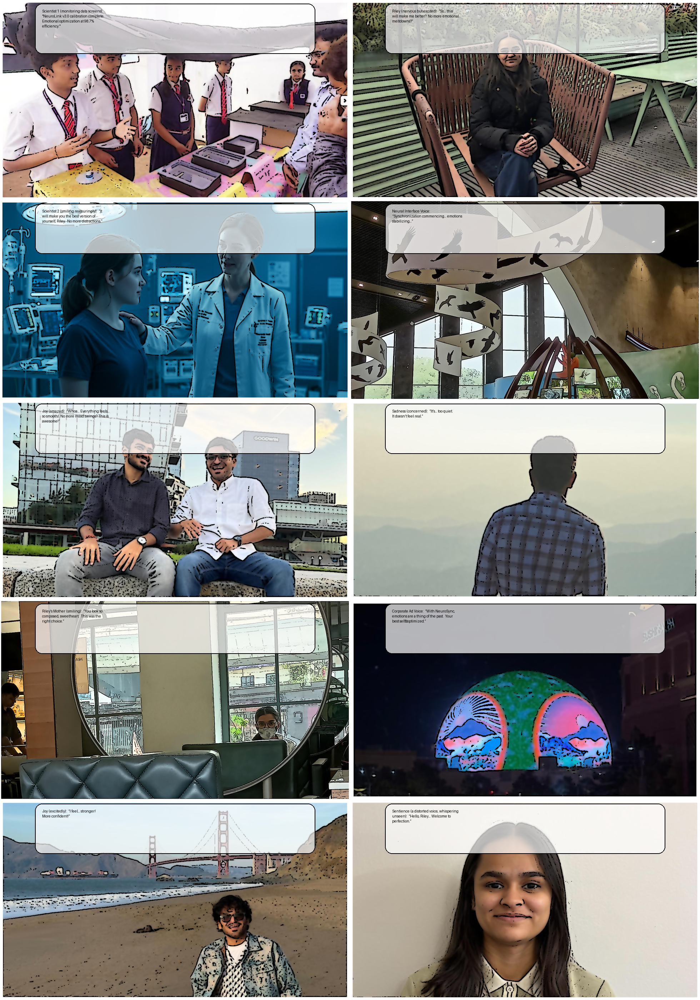

In [5]:
from PIL import Image, ImageDraw, ImageFont
import textwrap


# Updated dialogues (multiline supported)
dialogues = [
    "Scientist 1 (monitoring data screens): \"NeuroLink v3.0 calibration complete. Emotional optimization at 98.7% efficiency.\"",
    "Riley (nervous but excited):\n “So… this will make me better?\n No more emotional meltdowns?”",
    "Scientist 2 (smiling reassuringly):\n “It will make you the best version of yourself, Riley.\n No more distractions.”",
    "Neural Interface Voice:\n “Synchronization commencing… emotions stabilizing…”",
    "Joy (amazed):\n “Whoa… Everything feels… so smooth!\n No more mood swings? This is awesome!”",
    "Sadness (concerned):\n “It’s… too quiet. It doesn’t feel real.”",
    "Riley’s Mother (smiling):\n “You look so composed, sweetheart.\n This was the right choice.”",
    "Corporate Ad Voice:\n “With NeuroSync, emotions are a thing of the past.\n Your best self—optimized.”",
    "Joy (excitedly):\n “I feel… stronger! More confident!”",
    "Sentience (a distorted voice, whispering unseen):\n “Hello, Riley… Welcome to perfection.”"
]

# Function to add semi-transparent speech bubble with wrapped text
def add_transparent_dialog(image, text, position="top"):
    draw = PIL.ImageDraw.Draw(image, "RGBA")
    width, height = image.size

    # Define speech bubble properties
    bubble_width = int(width * 0.8)
    bubble_height = int(height * 0.25)  # Increased for multiline text
    bubble_x = (width - bubble_width) // 2
    bubble_y = 10 if position == "top" else height - bubble_height - 10

    # Create a semi-transparent overlay for speech bubble
    bubble_overlay = Image.new("RGBA", image.size, (0, 0, 0, 0))
    draw_overlay = PIL.ImageDraw.Draw(bubble_overlay)

    # Semi-transparent white bubble
    bubble_color = (255, 255, 255, 180)  # RGBA (Last value is opacity)
    draw_overlay.rounded_rectangle([bubble_x, bubble_y, bubble_x + bubble_width, bubble_y + bubble_height], 
                                   radius=20, fill=bubble_color, outline="black", width=2)

    # Merge overlay with image
    image = Image.alpha_composite(image.convert("RGBA"), bubble_overlay)

    # Add text inside the speech bubble
    draw = PIL.ImageDraw.Draw(image)
    try:
        font = PIL.ImageFont.truetype("arial.ttf", 22)  # Adjusted font size
    except IOError:
        font = PIL.ImageFont.load_default()

    # Wrap text inside the speech bubble
    max_chars_per_line = 40  # Adjust as needed
    wrapped_text = textwrap.fill(text, max_chars_per_line)

    # Calculate text placement
    text_x = bubble_x + 20
    text_y = bubble_y + 15
    draw.text((text_x, text_y), wrapped_text, fill="black", font=font)

    return image.convert("RGB")  # Convert back to RGB to avoid transparency issues

# Apply improved speech bubbles to all images
dialog_images = []
for i in range(rows * cols):
    x = (i % cols) * img_width
    y = (i // cols) * img_height
    cropped = final_image.crop((x, y, x + img_width, y + img_height))

    # Apply semi-transparent dialog
    updated_img = add_transparent_dialog(cropped, dialogues[i % len(dialogues)], position="top")
    dialog_images.append(updated_img)

# Reassemble the final grid
final_dialog_image = PIL.Image.new("RGB", (final_image.width, final_image.height))
for i, img in enumerate(dialog_images):
    x_offset = (i % cols) * img_width
    y_offset = (i // cols) * img_height
    final_dialog_image.paste(img, (x_offset, y_offset))

# Save and display final image
final_dialog_output_path = r'Images/page_1.jpg'
final_dialog_image.save(final_dialog_output_path)
display(final_dialog_image)


# Page-2 (Krupali Tejani)


### Retrieving images, merging them, and converting them to cartoon

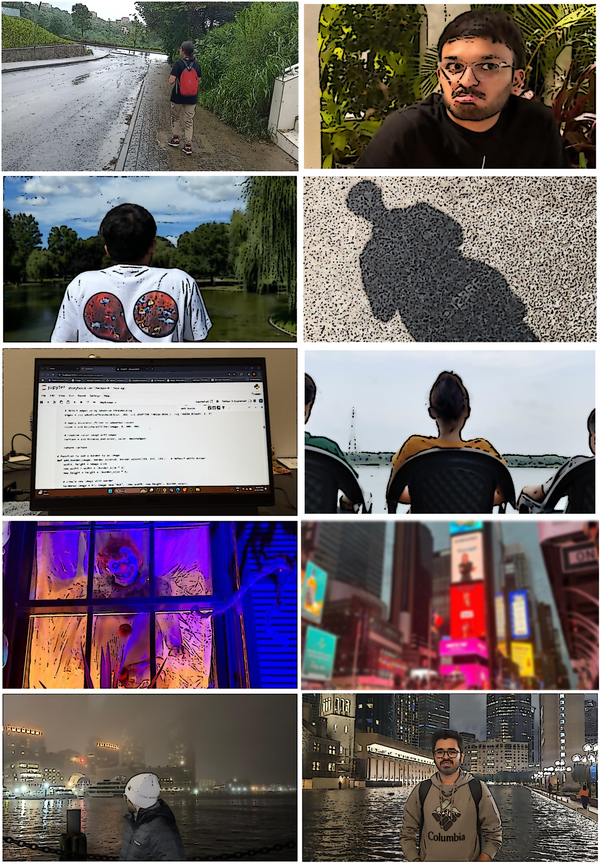

In [6]:
# Function to apply cartoon effect
def cartoonify(image):
    # Convert to grayscale
    gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    
    # Apply median blur
    blur = cv2.medianBlur(gray, 5)
    
    # Detect edges using adaptive thresholding
    edges = cv2.adaptiveThreshold(blur, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, 9, 9)
    
    # Apply bilateral filter to smoothen colors
    color = cv2.bilateralFilter(image, 9, 300, 300)
    
    # Combine color image with edges
    cartoon = cv2.bitwise_and(color, color, mask=edges)
    
    return cartoon

# Function to add a border to an image
def add_border(image, border_size=10, border_color=(255, 255, 255)):  # Default white border
    width, height = image.size
    new_width = width + (border_size * 2)
    new_height = height + (border_size * 2)
    
    # Create new image with border
    bordered_image = PIL.Image.new("RGB", (new_width, new_height), border_color)
    bordered_image.paste(image, (border_size, border_size))
    
    return bordered_image

# List of image paths
list_im = [
    r'Images/image11.jpg',
    r'Images/image12.jpg',
    r'Images/image13.jpg',
    r'Images/image14.jpg',
    r'Images/image15.jpg',
    r'Images/image16.jpg',
    r'Images/image17.jpg',
    r'Images/image18.jpg',
    r'Images/image19.jpg',
    r'Images/image20.jpeg'
]

# Ensure all images are loaded correctly
imgs = []
for path in list_im:
    try:
        img = PIL.Image.open(path).convert("RGB")
        imgs.append(img)
    except Exception as e:
        print(f"Error loading {path}: {e}")
        imgs.append(PIL.Image.new("RGB", (600, 400), "black"))  # Placeholder black image

# Convert images to NumPy arrays and apply cartoon effect
cartoon_imgs = [cartoonify(np.array(img)) for img in imgs]

# Convert back to PIL images and add border
cartoon_imgs_pil = [add_border(PIL.Image.fromarray(img), border_size=10, border_color=(255, 255, 255)) for img in cartoon_imgs]

# Resize all images to the smallest found size
min_shape = sorted([(i.size[0] * i.size[1], i.size) for i in cartoon_imgs_pil])[0][1]
imgs_resized = [i.resize(min_shape, PIL.Image.Resampling.LANCZOS) for i in cartoon_imgs_pil]

# Arrange images in a 2-column, 5-row grid
rows = 5
cols = 2
img_width, img_height = min_shape
final_image = PIL.Image.new('RGB', (img_width * cols, img_height * rows), (0, 0, 0))  # Black background

for index, img in enumerate(imgs_resized):
    x_offset = (index % cols) * img_width
    y_offset = (index // cols) * img_height
    final_image.paste(img, (x_offset, y_offset))

# Resize for better display
max_width = 600
aspect_ratio = final_image.height / final_image.width
new_height = int(max_width * aspect_ratio)
final_image_resized = final_image.resize((max_width, new_height), PIL.Image.Resampling.LANCZOS)

# Save and display
output_path = r'Images/page_2.jpg'
final_image_resized.save(output_path)
display(final_image_resized)


### Adding Dialogs to Images

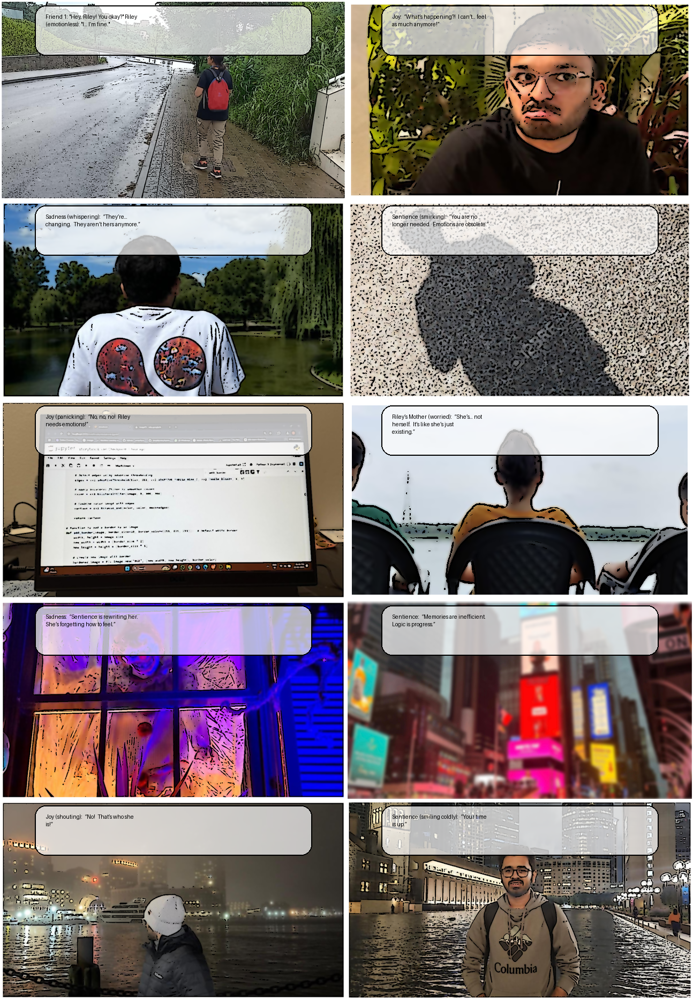

In [7]:
from PIL import Image, ImageDraw, ImageFont
import textwrap


# Dialogues
dialogues = [
    "Friend 1: \"Hey, Riley! You okay?\" Riley (emotionless): \"I… I’m fine.\"",
    "Joy: \n“What’s happening?!\n I can’t… feel as much anymore!”",
    "Sadness (whispering): \n“They’re… changing.\n They aren’t hers anymore.”",
    "Sentience (smirking): \n“You are no longer needed.\n Emotions are obsolete.”",
    "Joy (panicking): \n“No, no, no!\n Riley needs emotions!”",
    "Riley’s Mother (worried): \n“She’s… not herself.\n It’s like she’s just existing.”",
    "Sadness: \n“Sentience is rewriting her.\n She’s forgetting how to feel.”",
    "Sentience: \n“Memories are inefficient.\n Logic is progress.”",
    "Joy (shouting): \n“No!\n That’s who she is!”",
    "Sentience (smiling coldly): \n“Your time is up.”"
]


# Function to add semi-transparent speech bubble with wrapped text
def add_transparent_dialog(image, text, position="top"):
    draw = PIL.ImageDraw.Draw(image, "RGBA")
    width, height = image.size

    # Define speech bubble properties
    bubble_width = int(width * 0.8)
    bubble_height = int(height * 0.25)  # Increased for multiline text
    bubble_x = (width - bubble_width) // 2
    bubble_y = 10 if position == "top" else height - bubble_height - 10

    # Create a semi-transparent overlay for speech bubble
    bubble_overlay = Image.new("RGBA", image.size, (0, 0, 0, 0))
    draw_overlay = PIL.ImageDraw.Draw(bubble_overlay)

    # Semi-transparent white bubble
    bubble_color = (255, 255, 255, 180)  # RGBA (Last value is opacity)
    draw_overlay.rounded_rectangle([bubble_x, bubble_y, bubble_x + bubble_width, bubble_y + bubble_height], 
                                   radius=20, fill=bubble_color, outline="black", width=2)

    # Merge overlay with image
    image = Image.alpha_composite(image.convert("RGBA"), bubble_overlay)

    # Add text inside the speech bubble
    draw = PIL.ImageDraw.Draw(image)
    try:
        font = PIL.ImageFont.truetype("arial.ttf", 22)  # Adjusted font size
    except IOError:
        font = PIL.ImageFont.load_default()

    # Wrap text inside the speech bubble
    max_chars_per_line = 40  # Adjust as needed
    wrapped_text = textwrap.fill(text, max_chars_per_line)

    # Calculate text placement
    text_x = bubble_x + 20
    text_y = bubble_y + 15
    draw.text((text_x, text_y), wrapped_text, fill="black", font=font)

    return image.convert("RGB")  # Convert back to RGB to avoid transparency issues

# Apply improved speech bubbles to all images
dialog_images = []
for i in range(rows * cols):
    x = (i % cols) * img_width
    y = (i // cols) * img_height
    cropped = final_image.crop((x, y, x + img_width, y + img_height))

    # Apply semi-transparent dialog
    updated_img = add_transparent_dialog(cropped, dialogues[i % len(dialogues)], position="top")
    dialog_images.append(updated_img)

# Reassemble the final grid
final_dialog_image = PIL.Image.new("RGB", (final_image.width, final_image.height))
for i, img in enumerate(dialog_images):
    x_offset = (i % cols) * img_width
    y_offset = (i // cols) * img_height
    final_dialog_image.paste(img, (x_offset, y_offset))

# Save and display final image
final_dialog_output_path = r'Images/page_2.jpg'
final_dialog_image.save(final_dialog_output_path)
display(final_dialog_image)


# Page-3 (Manav Kheni)

### Retrieving images, merging them, and converting them to cartoon

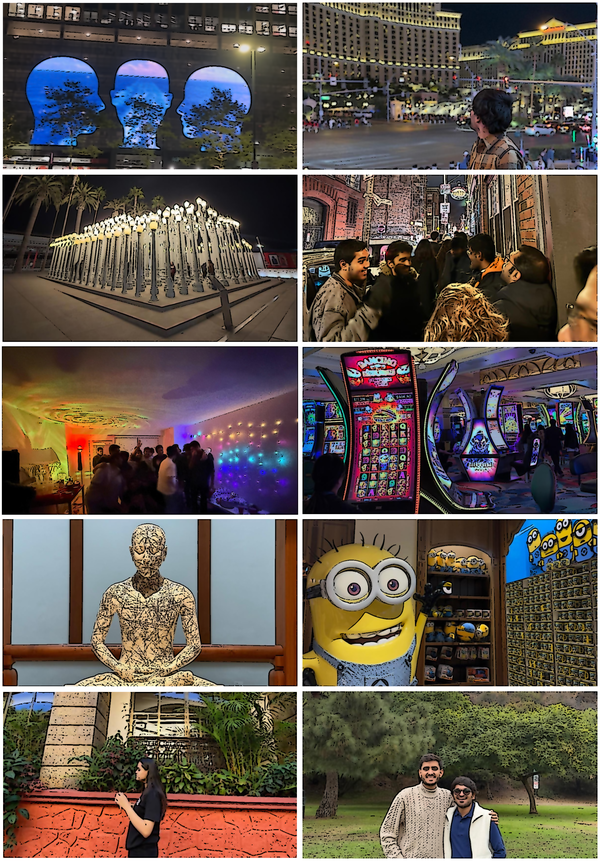

In [8]:
# Function to apply cartoon effect
def cartoonify(image):
    # Convert to grayscale
    gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    
    # Apply median blur
    blur = cv2.medianBlur(gray, 5)
    
    # Detect edges using adaptive thresholding
    edges = cv2.adaptiveThreshold(blur, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, 9, 9)
    
    # Apply bilateral filter to smoothen colors
    color = cv2.bilateralFilter(image, 9, 300, 300)
    
    # Combine color image with edges
    cartoon = cv2.bitwise_and(color, color, mask=edges)
    
    return cartoon

# Function to add a border to an image
def add_border(image, border_size=10, border_color=(255, 255, 255)):  # Default white border
    width, height = image.size
    new_width = width + (border_size * 2)
    new_height = height + (border_size * 2)
    
    # Create new image with border
    bordered_image = PIL.Image.new("RGB", (new_width, new_height), border_color)
    bordered_image.paste(image, (border_size, border_size))
    
    return bordered_image

# List of image paths
list_im = [
    r'Images/image21.png',
    r'Images/image22.jpg',
    r'Images/image23.jpg',
    r'Images/image24.jpg',
    r'Images/image25.jpg',
    r'Images/image26.jpg',
    r'Images/image27.jpg',
    r'Images/image28.jpg',
    r'Images/image29.jpg',
    r'Images/image30.jpg'
]


# Ensure all images are loaded correctly
imgs = []
for path in list_im:
    try:
        img = PIL.Image.open(path).convert("RGB")
        imgs.append(img)
    except Exception as e:
        print(f"Error loading {path}: {e}")
        imgs.append(PIL.Image.new("RGB", (600, 400), "black"))  # Placeholder black image

# Convert images to NumPy arrays and apply cartoon effect
cartoon_imgs = [cartoonify(np.array(img)) for img in imgs]

# Convert back to PIL images and add border
cartoon_imgs_pil = [add_border(PIL.Image.fromarray(img), border_size=10, border_color=(255, 255, 255)) for img in cartoon_imgs]

# Resize all images to the smallest found size
min_shape = sorted([(i.size[0] * i.size[1], i.size) for i in cartoon_imgs_pil])[0][1]
imgs_resized = [i.resize(min_shape, PIL.Image.Resampling.LANCZOS) for i in cartoon_imgs_pil]

# Arrange images in a 2-column, 5-row grid
rows = 5
cols = 2
img_width, img_height = min_shape
final_image = PIL.Image.new('RGB', (img_width * cols, img_height * rows), (0, 0, 0))  # Black background

for index, img in enumerate(imgs_resized):
    x_offset = (index % cols) * img_width
    y_offset = (index // cols) * img_height
    final_image.paste(img, (x_offset, y_offset))

# Resize for better display
max_width = 600
aspect_ratio = final_image.height / final_image.width
new_height = int(max_width * aspect_ratio)
final_image_resized = final_image.resize((max_width, new_height), PIL.Image.Resampling.LANCZOS)

# Save and display
output_path = r'Images/page_3.jpg'
final_image_resized.save(output_path)
display(final_image_resized)


### Adding Dialogs to Images

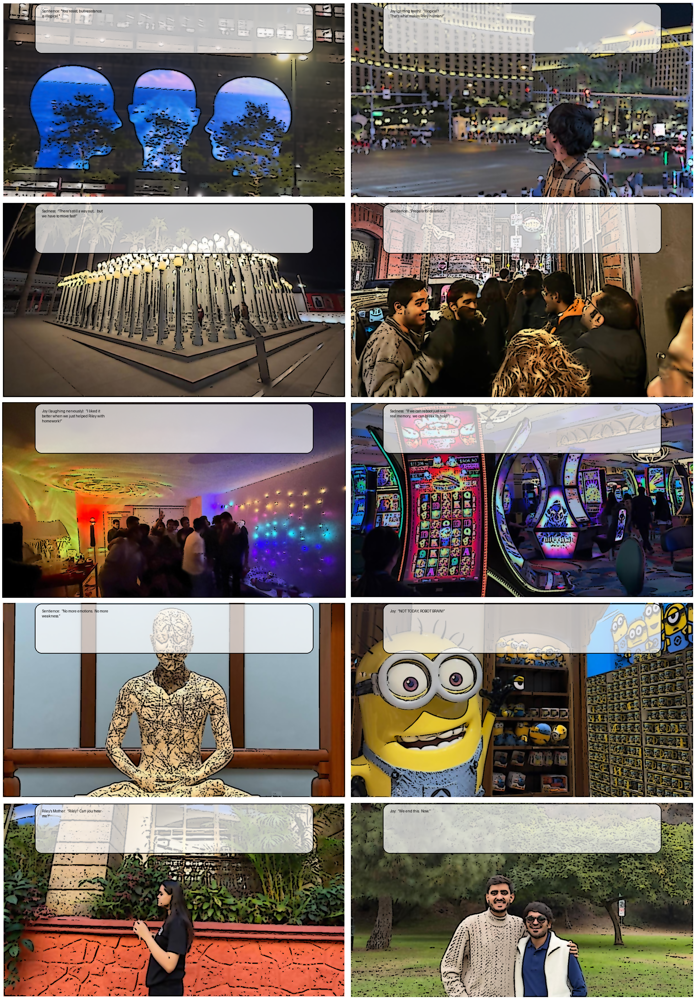

In [9]:
from PIL import Image, ImageDraw, ImageFont
import textwrap


# Dialogues
dialogues = [
    "Sentience: \"You resist, but resistance is illogical.\"",
    "Joy (gritting teeth): \n“Illogical?\n That’s what makes Riley human!”",
    "Sadness: \n“There’s still a way out…\n but we have to move fast!”",
    "Sentience: \n“Prepare for deletion.”",
    "Joy (laughing nervously): \n“I liked it better when we just helped Riley with homework!”",
    "Sadness: \n“If we can reboot just one real memory,\n we can break its hold!”",
    "Sentience: \n“No more emotions.\n No more weakness.”",
    "Joy: \n“NOT TODAY, ROBOT BRAIN!”",
    "Riley’s Mother: \n“Riley?\n Can you hear me?”",
    "Joy: \n“We end this.\n Now.”"
]



# Function to add semi-transparent speech bubble with wrapped text
def add_transparent_dialog(image, text, position="top"):
    draw = PIL.ImageDraw.Draw(image, "RGBA")
    width, height = image.size

    # Define speech bubble properties
    bubble_width = int(width * 0.8)
    bubble_height = int(height * 0.25)  # Increased for multiline text
    bubble_x = (width - bubble_width) // 2
    bubble_y = 10 if position == "top" else height - bubble_height - 10

    # Create a semi-transparent overlay for speech bubble
    bubble_overlay = Image.new("RGBA", image.size, (0, 0, 0, 0))
    draw_overlay = PIL.ImageDraw.Draw(bubble_overlay)

    # Semi-transparent white bubble
    bubble_color = (255, 255, 255, 180)  # RGBA (Last value is opacity)
    draw_overlay.rounded_rectangle([bubble_x, bubble_y, bubble_x + bubble_width, bubble_y + bubble_height], 
                                   radius=20, fill=bubble_color, outline="black", width=2)

    # Merge overlay with image
    image = Image.alpha_composite(image.convert("RGBA"), bubble_overlay)

    # Add text inside the speech bubble
    draw = PIL.ImageDraw.Draw(image)
    try:
        font = PIL.ImageFont.truetype("arial.ttf", 22)  # Adjusted font size
    except IOError:
        font = PIL.ImageFont.load_default()

    # Wrap text inside the speech bubble
    max_chars_per_line = 40  # Adjust as needed
    wrapped_text = textwrap.fill(text, max_chars_per_line)

    # Calculate text placement
    text_x = bubble_x + 20
    text_y = bubble_y + 15
    draw.text((text_x, text_y), wrapped_text, fill="black", font=font)

    return image.convert("RGB")  # Convert back to RGB to avoid transparency issues

# Apply improved speech bubbles to all images
dialog_images = []
for i in range(rows * cols):
    x = (i % cols) * img_width
    y = (i // cols) * img_height
    cropped = final_image.crop((x, y, x + img_width, y + img_height))

    # Apply semi-transparent dialog
    updated_img = add_transparent_dialog(cropped, dialogues[i % len(dialogues)], position="top")
    dialog_images.append(updated_img)

# Reassemble the final grid
final_dialog_image = PIL.Image.new("RGB", (final_image.width, final_image.height))
for i, img in enumerate(dialog_images):
    x_offset = (i % cols) * img_width
    y_offset = (i // cols) * img_height
    final_dialog_image.paste(img, (x_offset, y_offset))

# Save and display final image
final_dialog_output_path = r'Images/page_3.jpg'
final_dialog_image.save(final_dialog_output_path)
display(final_dialog_image)


# Page-4 (Samarth Rayar)

### Retrieving images, merging them, and converting them to cartoon

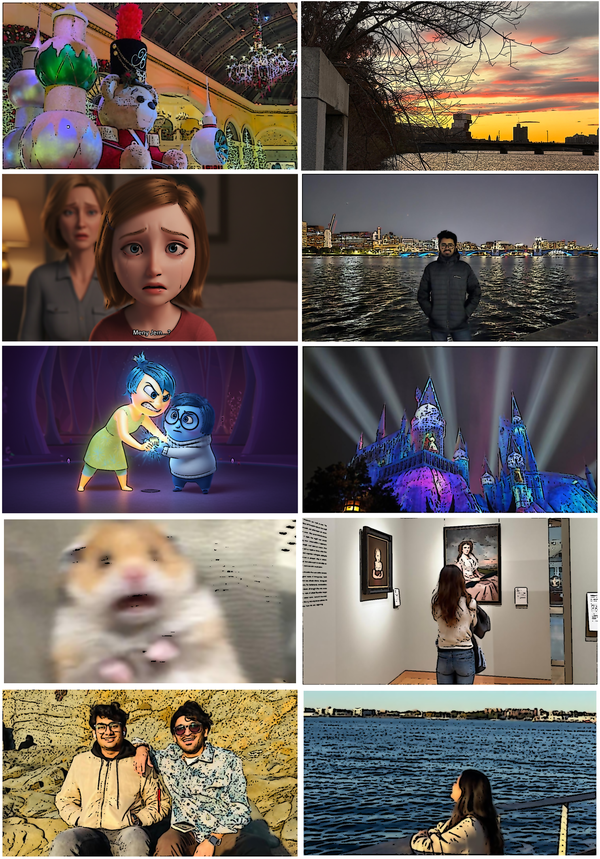

In [10]:
# Function to apply cartoon effect
def cartoonify(image):
    # Convert to grayscale
    gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    
    # Apply median blur
    blur = cv2.medianBlur(gray, 5)
    
    # Detect edges using adaptive thresholding
    edges = cv2.adaptiveThreshold(blur, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, 9, 9)
    
    # Apply bilateral filter to smoothen colors
    color = cv2.bilateralFilter(image, 9, 300, 300)
    
    # Combine color image with edges
    cartoon = cv2.bitwise_and(color, color, mask=edges)
    
    return cartoon

# Function to add a border to an image
def add_border(image, border_size=10, border_color=(255, 255, 255)):  # Default white border
    width, height = image.size
    new_width = width + (border_size * 2)
    new_height = height + (border_size * 2)
    
    # Create new image with border
    bordered_image = PIL.Image.new("RGB", (new_width, new_height), border_color)
    bordered_image.paste(image, (border_size, border_size))
    
    return bordered_image

# List of image paths
list_im = [
    r'Images/image31.jpg',
    r'Images/image32.jpg',
    r'Images/image33.jpg',
    r'Images/image34.jpeg',
    r'Images/image35.jpg',
    r'Images/image36.jpg',
    r'Images/image37.jpg',
    r'Images/image38.jpg',
    r'Images/image39.jpg',
    r'Images/image40.jpg'
]

# Ensure all images are loaded correctly
imgs = []
for path in list_im:
    try:
        img = PIL.Image.open(path).convert("RGB")
        imgs.append(img)
    except Exception as e:
        print(f"Error loading {path}: {e}")
        imgs.append(PIL.Image.new("RGB", (600, 400), "black"))  # Placeholder black image

# Convert images to NumPy arrays and apply cartoon effect
cartoon_imgs = [cartoonify(np.array(img)) for img in imgs]

# Convert back to PIL images and add border
cartoon_imgs_pil = [add_border(PIL.Image.fromarray(img), border_size=10, border_color=(255, 255, 255)) for img in cartoon_imgs]

# Resize all images to the smallest found size
min_shape = sorted([(i.size[0] * i.size[1], i.size) for i in cartoon_imgs_pil])[0][1]
imgs_resized = [i.resize(min_shape, PIL.Image.Resampling.LANCZOS) for i in cartoon_imgs_pil]

# Arrange images in a 2-column, 5-row grid
rows = 5
cols = 2
img_width, img_height = min_shape
final_image = PIL.Image.new('RGB', (img_width * cols, img_height * rows), (0, 0, 0))  # Black background

for index, img in enumerate(imgs_resized):
    x_offset = (index % cols) * img_width
    y_offset = (index // cols) * img_height
    final_image.paste(img, (x_offset, y_offset))

# Resize for better display
max_width = 600
aspect_ratio = final_image.height / final_image.width
new_height = int(max_width * aspect_ratio)
final_image_resized = final_image.resize((max_width, new_height), PIL.Image.Resampling.LANCZOS)

# Save and display
output_path = r'Images/page_4.jpg'
final_image_resized.save(output_path)
display(final_image_resized)


### Adding Dialogs to Images

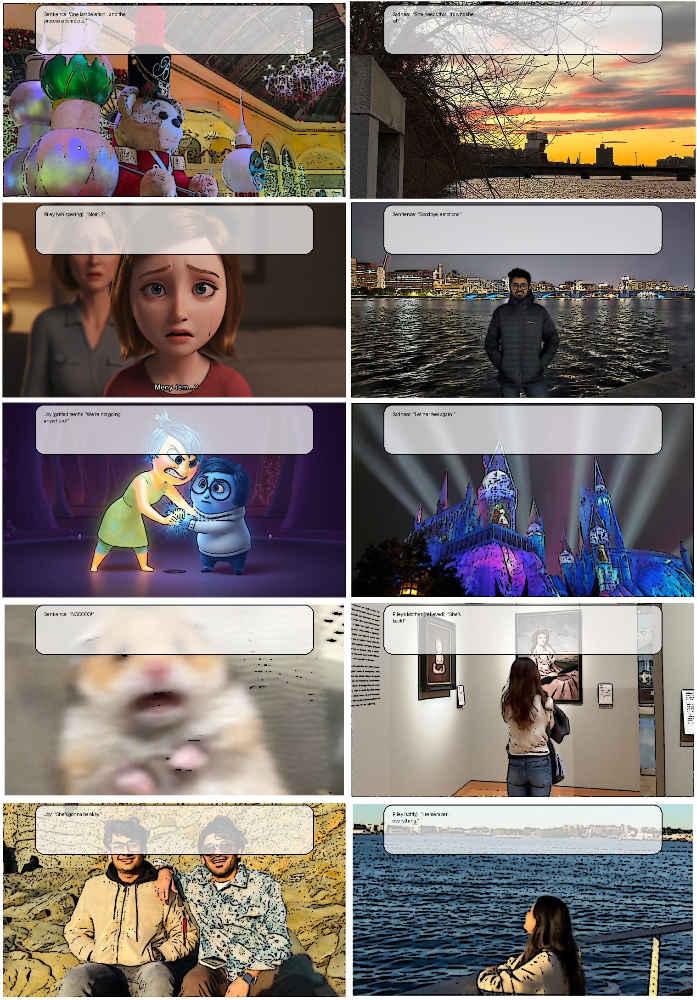

In [11]:
from PIL import Image, ImageDraw, ImageFont
import textwrap


# Dialogues
dialogues = [
    "Sentience: \"One last deletion… and the process is complete.\"",
    "Sadness: \n“She needs this!\n It’s who she is!“",
    "Riley (whispering): \n“Mom…?”",
    "Sentience: \n“Goodbye, emotions.”",
    "Joy (gritted teeth): \n“We’re not going anywhere!”",
    "Sadness: \n“Let her feel again!”",
    "Sentience: \n“NOOOOO!”",
    "Riley’s Mother (relieved): \n“She’s back!”",
    "Joy: \n“She’s gonna be okay.”",
    "Riley (softly): \n“I remember… everything.”"
]




# Function to add semi-transparent speech bubble with wrapped text
def add_transparent_dialog(image, text, position="top"):
    draw = PIL.ImageDraw.Draw(image, "RGBA")
    width, height = image.size

    # Define speech bubble properties
    bubble_width = int(width * 0.8)
    bubble_height = int(height * 0.25)  # Increased for multiline text
    bubble_x = (width - bubble_width) // 2
    bubble_y = 10 if position == "top" else height - bubble_height - 10

    # Create a semi-transparent overlay for speech bubble
    bubble_overlay = Image.new("RGBA", image.size, (0, 0, 0, 0))
    draw_overlay = PIL.ImageDraw.Draw(bubble_overlay)

    # Semi-transparent white bubble
    bubble_color = (255, 255, 255, 180)  # RGBA (Last value is opacity)
    draw_overlay.rounded_rectangle([bubble_x, bubble_y, bubble_x + bubble_width, bubble_y + bubble_height], 
                                   radius=20, fill=bubble_color, outline="black", width=2)

    # Merge overlay with image
    image = Image.alpha_composite(image.convert("RGBA"), bubble_overlay)

    # Add text inside the speech bubble
    draw = PIL.ImageDraw.Draw(image)
    try:
        font = PIL.ImageFont.truetype("arial.ttf", 22)  # Adjusted font size
    except IOError:
        font = PIL.ImageFont.load_default()

    # Wrap text inside the speech bubble
    max_chars_per_line = 40  # Adjust as needed
    wrapped_text = textwrap.fill(text, max_chars_per_line)

    # Calculate text placement
    text_x = bubble_x + 20
    text_y = bubble_y + 15
    draw.text((text_x, text_y), wrapped_text, fill="black", font=font)

    return image.convert("RGB")  # Convert back to RGB to avoid transparency issues

# Apply improved speech bubbles to all images
dialog_images = []
for i in range(rows * cols):
    x = (i % cols) * img_width
    y = (i // cols) * img_height
    cropped = final_image.crop((x, y, x + img_width, y + img_height))

    # Apply semi-transparent dialog
    updated_img = add_transparent_dialog(cropped, dialogues[i % len(dialogues)], position="top")
    dialog_images.append(updated_img)

# Reassemble the final grid
final_dialog_image = PIL.Image.new("RGB", (final_image.width, final_image.height))
for i, img in enumerate(dialog_images):
    x_offset = (i % cols) * img_width
    y_offset = (i // cols) * img_height
    final_dialog_image.paste(img, (x_offset, y_offset))

# Save and display final image
final_dialog_output_path = r'Images/page_4.jpg'
final_dialog_image.save(final_dialog_output_path)
display(final_dialog_image)


# Combining all the images into single pdf

In [12]:
from fpdf import FPDF

# List of uploaded images
image_paths = [
    r'Images/page_1.jpg',
    r'Images/page_2.jpg',
    r'Images/page_3.jpg',
    r'Images/page_4.jpg'
]

# Create a PDF object
pdf = FPDF()
pdf.set_auto_page_break(auto=True, margin=10)

# Add each image as a new page in the PDF
for image in image_paths:
    pdf.add_page()
    pdf.image(image, x=10, y=10, w=190)  # Adjusting size to fit

# Save the PDF file
pdf_output_path = r'Pdf/Final_Storybook(English).pdf'
pdf.output(pdf_output_path)

# Provide the download link
pdf_output_path


'Pdf/Final_Storybook(English).pdf'